<center style="border-radius:10px;
padding: 3rem 2rem;
border: 3px solid #F54257;
">
<h1 style="color:#F54257; 
font-size:3.0rem;
margin:0;
">KITTI Object Detection</h1>
<h2 style="color:#F54257; 
font-size:2.0rem;
margin-top:1rem;
margin-bottom:2.5rem;
">YOLOv8n | Ultralytics</h2>
<a href="https://kaggle.com/shreydan" style="color: white;
background-color: #F54257;
border-radius: 25px;
padding: 1rem 1.5rem;
text-decoration: none;
">@shreydan</a>
</center>

# Imports
<div style="width:100%;height:0;border-bottom: 3px solid #F03A4F;margin-bottom: 1rem;"></div>

In [1]:
!pip install ultralytics -q


[notice] A new release of pip is available: 23.0.1 -> 24.0
[notice] To update, run: python3.10 -m pip install --upgrade pip


In [2]:
%env WANDB_DISABLED=True

env: WANDB_DISABLED=True


In [3]:
from ultralytics import YOLO
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path
import json
from sklearn.model_selection import train_test_split
from tqdm.auto import tqdm
import shutil
from PIL import Image

# Preparing Dataset
<div style="width:100%;height:0;border-bottom: 3px solid #F27B40;margin-bottom: 1rem;"></div>

In [13]:
base_dir = Path('/Users/shuttlesworthneo/Depository/OMSCS/Deep Learning/project/methOD/yolov8-kitti/data/KITTI')
img_path = base_dir / 'training' / 'image_2'
label_path = base_dir / 'training' / 'labels_2'
with open(base_dir / 'training' / 'classes.json','r') as f:
    classes = json.load(f)

classes

{'Car': 0,
 'Pedestrian': 1,
 'Van': 2,
 'Cyclist': 3,
 'Truck': 4,
 'Misc': 5,
 'Tram': 6,
 'Person_sitting': 7,
 'DontCare': 8}

In [15]:
ims = sorted(list(img_path.glob('*')))
labels = sorted(list(label_path.glob('*')))
pairs = list(zip(ims,labels))
pairs[:2]

[(PosixPath('/Users/shuttlesworthneo/Depository/OMSCS/Deep Learning/project/methOD/yolov8-kitti/data/KITTI/training/image_2/000000.png'),
  PosixPath('/Users/shuttlesworthneo/Depository/OMSCS/Deep Learning/project/methOD/yolov8-kitti/data/KITTI/training/labels_2/000000.txt')),
 (PosixPath('/Users/shuttlesworthneo/Depository/OMSCS/Deep Learning/project/methOD/yolov8-kitti/data/KITTI/training/image_2/000001.png'),
  PosixPath('/Users/shuttlesworthneo/Depository/OMSCS/Deep Learning/project/methOD/yolov8-kitti/data/KITTI/training/labels_2/000001.txt'))]

# Preparing File Structure
<div style="width:100%;height:0;border-bottom: 3px solid #F4B343;margin-bottom: 1rem;"></div>

```
/kaggle/working
    |
    -train
    |   |
    |   -000000.png
    |   -000000.txt
    |   ...
    |
    -val
      |
      -000001.png
      -000001.txt
      ...
```

In [16]:
train, test = train_test_split(pairs,test_size=0.1,shuffle=True)
len(train), len(test)

(6732, 749)

In [17]:
train_path = Path('train').resolve()
train_path.mkdir(exist_ok=True)
valid_path = Path('valid').resolve()
valid_path.mkdir(exist_ok=True)

In [18]:
for t_img, t_lb in tqdm(train):
    im_path = train_path / t_img.name
    lb_path = train_path / t_lb.name
    shutil.copy(t_img,im_path)
    shutil.copy(t_lb,lb_path)

  0%|          | 0/6732 [00:00<?, ?it/s]

In [19]:
for t_img, t_lb in tqdm(test):
    im_path = valid_path / t_img.name
    lb_path = valid_path / t_lb.name
    shutil.copy(t_img,im_path)
    shutil.copy(t_lb,lb_path)

  0%|          | 0/749 [00:00<?, ?it/s]

# YAML file for the data
<div style="width:100%;height:0;border-bottom: 3px solid #F4CE45;margin-bottom: 1rem;"></div>

In [20]:
yaml_file = 'names:\n'
yaml_file += '\n'.join(f'- {c}' for c in classes)
yaml_file += f'\nnc: {len(classes)}'
yaml_file += f'\ntrain: {str(train_path)}\nval: {str(valid_path)}'
with open('kitti.yaml','w') as f:
    f.write(yaml_file)

In [21]:
!cat kitti.yaml

names:
- Car
- Pedestrian
- Van
- Cyclist
- Truck
- Misc
- Tram
- Person_sitting
- DontCare
nc: 9
train: /Users/shuttlesworthneo/Depository/OMSCS/Deep Learning/project/methOD/yolov8-kitti/train
val: /Users/shuttlesworthneo/Depository/OMSCS/Deep Learning/project/methOD/yolov8-kitti/valid

# Model
<div style="width:100%;height:0;border-bottom: 3px solid #F27B40;margin-bottom: 1rem;"></div>

In [22]:
model = YOLO('yolov8n.yaml')
model = YOLO('yolov8n.pt')

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6.23M/6.23M [00:01<00:00, 3.46MB/s]


# Training
<div style="width:100%;height:0;border-bottom: 3px solid #F5E947;margin-bottom: 1rem;"></div>

In [32]:
train_results = model.train(
    data='/Users/shuttlesworthneo/Depository/OMSCS/Deep Learning/project/methOD/yolov8-kitti/kitti.yaml', 
    epochs=50,
    patience=3,
    mixup=0.1,
    project='yolov8n-kitti',
    device="mps"
)

Ultralytics YOLOv8.2.1 🚀 Python-3.10.14 torch-2.2.2 MPS (Apple M1 Pro)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/Users/shuttlesworthneo/Depository/OMSCS/Deep Learning/project/methOD/yolov8-kitti/kitti.yaml, epochs=50, time=None, patience=3, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=mps, workers=0, project=yolov8n-kitti, name=train34, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=Fals

train: Scanning /Users/shuttlesworthneo/Depository/OMSCS/Deep Learning/project/methOD/yolov8-kitti/train.cache... 6732 images, 0 backgrounds, 0 corrupt: 100%|██████████| 6732/6732 [00:00<?, ?it/s]
val: Scanning /Users/shuttlesworthneo/Depository/OMSCS/Deep Learning/project/methOD/yolov8-kitti/valid.cache... 749 images, 0 backgrounds, 0 corrupt: 100%|██████████| 749/749 [00:00<?, ?it/s]

Plotting labels to yolov8n-kitti/train34/labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000769, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to yolov8n-kitti/train34
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50         0G          0        nan          0         83        640: 100%|██████████| 421/421 [21:06<00:00,  3.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:27<00:00,  1.14s/it]

                   all        749       5098          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50         0G        nan        nan        nan         77        640: 100%|██████████| 421/421 [22:05<00:00,  3.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:38<00:00,  1.61s/it]

                   all        749       5098          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50         0G        nan        nan        nan         85        640: 100%|██████████| 421/421 [35:03<00:00,  5.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [01:08<00:00,  2.86s/it]

                   all        749       5098          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50         0G        nan        nan        nan         94        640: 100%|██████████| 421/421 [39:19<00:00,  5.60s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [01:07<00:00,  2.79s/it]

                   all        749       5098          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50         0G        nan        nan        nan        100        640: 100%|██████████| 421/421 [36:59<00:00,  5.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:53<00:00,  2.24s/it]

                   all        749       5098          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50         0G        nan        nan        nan         97        640: 100%|██████████| 421/421 [38:18<00:00,  5.46s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [17:35<00:00, 43.98s/it] 

                   all        749       5098          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50         0G        nan        nan        nan        128        640:   8%|▊         | 35/421 [13:21<2:27:16, 22.89s/it] 


RuntimeError: MPS backend out of memory (MPS allocated: 3.58 GB, other allocations: 14.48 GB, max allowed: 18.13 GB). Tried to allocate 100.00 MB on private pool. Use PYTORCH_MPS_HIGH_WATERMARK_RATIO=0.0 to disable upper limit for memory allocations (may cause system failure).

# Validation
<div style="width:100%;height:0;border-bottom: 3px solid #E7F549;margin-bottom: 1rem;"></div>

In [27]:
valid_results = model.val()

Ultralytics YOLOv8.2.1 🚀 Python-3.10.14 torch-2.2.2 MPS (Apple M1 Pro)
Model summary (fused): 168 layers, 3007403 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /Users/shuttlesworthneo/Depository/OMSCS/Deep Learning/project/methOD/yolov8-kitti/valid.cache... 749 images, 0 backgrounds, 0 corrupt: 100%|██████████| 749/749 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:36<00:00,  1.27it/s]

                   all        749       5098          0          0          0          0


Speed: 1.0ms preprocess, 25.2ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to yolov8n-kitti/train32


# Results
<div style="width:100%;height:0;border-bottom: 3px solid #F25F3E;margin-bottom: 1rem;"></div>

In [30]:
plt.figure(figsize=(10,20))
plt.imshow(Image.open(f'/Users/shuttlesworthneo/Depository/OMSCS/Deep Learning/project/methOD/yolov8-kitti/yolov8n-kitti/train3/results.png'))
plt.axis('off')
plt.show()

<Figure size 1000x2000 with 0 Axes>

<Figure size 1000x2000 with 0 Axes>

<Figure size 1000x2000 with 1 Axes>

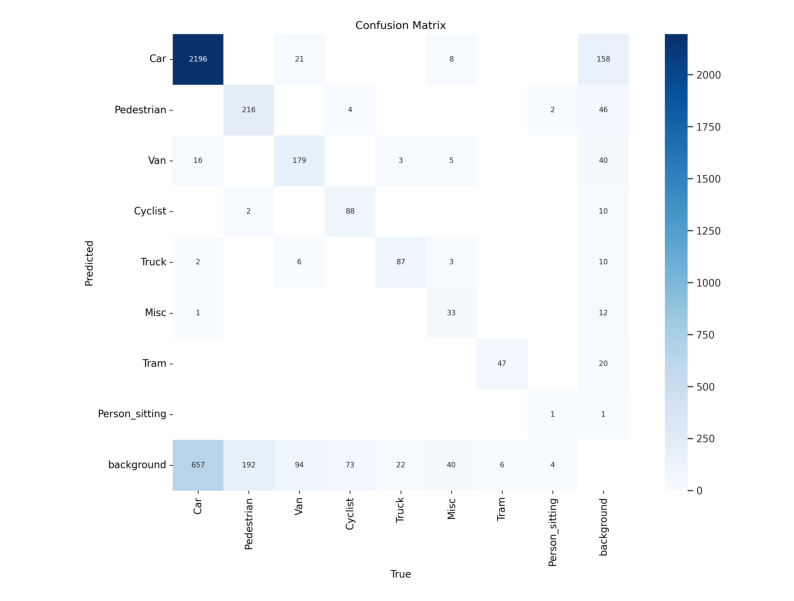

In [16]:
plt.figure(figsize=(10,20))
plt.imshow(Image.open('/kaggle/working/yolov8n-kitti/val/confusion_matrix.png'))
plt.axis('off')
plt.show()

# Predictions
<div style="width:100%;height:0;border-bottom: 3px solid #CEF64B;margin-bottom: 1rem;"></div>

In [31]:
preds = model.predict([test[idx][0] for idx in np.random.randint(0,len(test),(20,))],save=True)


0: 640x640 (no detections), 215.1ms
1: 640x640 (no detections), 215.1ms
2: 640x640 (no detections), 215.1ms
3: 640x640 (no detections), 215.1ms
4: 640x640 (no detections), 215.1ms
5: 640x640 (no detections), 215.1ms
6: 640x640 (no detections), 215.1ms
7: 640x640 (no detections), 215.1ms
8: 640x640 (no detections), 215.1ms
9: 640x640 (no detections), 215.1ms
10: 640x640 (no detections), 215.1ms
11: 640x640 (no detections), 215.1ms
12: 640x640 (no detections), 215.1ms
13: 640x640 (no detections), 215.1ms
14: 640x640 (no detections), 215.1ms
15: 640x640 (no detections), 215.1ms
16: 640x640 (no detections), 215.1ms
17: 640x640 (no detections), 215.1ms
18: 640x640 (no detections), 215.1ms
19: 640x640 (no detections), 215.1ms
Speed: 15.8ms preprocess, 215.1ms inference, 14.9ms postprocess per image at shape (1, 3, 640, 640)
Results saved to yolov8n-kitti/train33


In [18]:
preds = list(Path('yolov8n-kitti/predict').glob('*'))

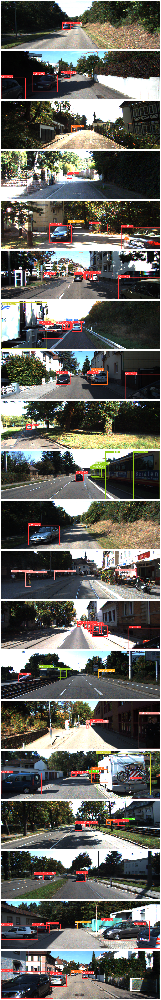

In [19]:
def plot_images(images):
    num_images = len(images)
    rows = num_images
    cols = 1
    fig, axes = plt.subplots(rows, cols, figsize=(15, 80))
    for ax in axes.flat:
        ax.axis('off')
    for i, img_path in enumerate(images):
        img = Image.open(img_path)
        axes[i].imshow(img)
    
    plt.tight_layout()
    plt.show()
    
plot_images(preds)

## cleanup

In [20]:
!cp /kaggle/working/yolov8n-kitti/train/weights/best.pt /kaggle/working/

In [21]:
!zip -r results.zip yolov8n-kitti

  adding: yolov8n-kitti/ (stored 0%)
  adding: yolov8n-kitti/val/ (stored 0%)
  adding: yolov8n-kitti/val/R_curve.png (deflated 5%)
  adding: yolov8n-kitti/val/val_batch1_labels.jpg (deflated 11%)
  adding: yolov8n-kitti/val/PR_curve.png (deflated 8%)
  adding: yolov8n-kitti/val/val_batch2_pred.jpg (deflated 9%)
  adding: yolov8n-kitti/val/val_batch0_labels.jpg (deflated 10%)
  adding: yolov8n-kitti/val/P_curve.png (deflated 7%)
  adding: yolov8n-kitti/val/val_batch0_pred.jpg (deflated 10%)
  adding: yolov8n-kitti/val/confusion_matrix.png (deflated 22%)
  adding: yolov8n-kitti/val/val_batch1_pred.jpg (deflated 11%)
  adding: yolov8n-kitti/val/confusion_matrix_normalized.png (deflated 20%)
  adding: yolov8n-kitti/val/F1_curve.png (deflated 5%)
  adding: yolov8n-kitti/val/val_batch2_labels.jpg (deflated 10%)
  adding: yolov8n-kitti/predict/ (stored 0%)
  adding: yolov8n-kitti/predict/006880.png (deflated 0%)
  adding: yolov8n-kitti/predict/001273.png (deflated 0%)
  adding: yolov8n-kitti

In [22]:
!rm -rf yolov8n-kitti wandb train.cache valid.cache yolov8n.pt train valid